### ML Experiments

In [5]:
# import io
# import base64
# import datetime
# import torchvision.transforms as transforms
# from torchvision import models
# from PIL import Image
# import json

# # model
# model = models.densenet121(pretrained=True)
# model.eval()

# # imagenet classes
# imagenet_class_index = json.load(open('./static/imagenet_class_index.json'))


# def transform_image(image_bytes):
#     my_transforms = transforms.Compose([transforms.Resize(255),
#                                         transforms.CenterCrop(224),
#                                         transforms.ToTensor(),
#                                         transforms.Normalize(
#                                             [0.485, 0.456, 0.406],
#                                             [0.229, 0.224, 0.225])])
#     image = Image.open(io.BytesIO(image_bytes))
#     return my_transforms(image).unsqueeze(0)


# def get_prediction(image_bytes):
#     tensor = transform_image(image_bytes=image_bytes)
#     outputs = model.forward(tensor)
#     _, y_hat = outputs.max(1)
#     predicted_idx = str(y_hat.item())
#     return imagenet_class_index[predicted_idx]


# def get_result(image_file, is_api=False):
#     start_time = datetime.datetime.now()
#     image_bytes = image_file.file.read()
#     class_id, class_name = get_prediction(image_bytes)
#     end_time = datetime.datetime.now()
#     time_diff = (end_time - start_time)
#     execution_time = f'{round(time_diff.total_seconds() * 1000)} ms'
#     encoded_string = base64.b64encode(image_bytes)
#     bs64 = encoded_string.decode('utf-8')
#     image_data = f'data:image/jpeg;base64,{bs64}'
#     result = {
#         "inference_time": execution_time,
#         "predictions": {
#             "class_id": class_id,
#             "class_name": class_name
#         }
#     }
#     if not is_api:
#         result["image_data"] = image_data
#     return result


In [1]:
import io
import base64
import datetime
import torchvision.transforms as transforms
from torchvision import models
from PIL import Image
import json

In [2]:
# model
model = models.densenet121(pretrained=True)
model.eval()

/home/kvshetenex/anaconda3/envs/mhi_few_shot/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/kvshetenex/anaconda3/envs/mhi_few_shot/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

In [5]:
# imagenet classes
imagenet_class_index = json.load(open(
    'imagenet_class_index.json'))


In [46]:
# working

# def transform_image(image_bytes):
#     my_transforms = transforms.Compose([transforms.Resize(255),
#                                         transforms.CenterCrop(224),
#                                         transforms.ToTensor(),
#                                         transforms.Normalize(
#                                             [0.485, 0.456, 0.406],
#                                             [0.229, 0.224, 0.225])])
#     image = Image.open(image_file_path)
#     return my_transforms(image).unsqueeze(0)

In [6]:
def transform_image(image_bytes):
    my_transforms = transforms.Compose([transforms.Resize(255),
                                        transforms.CenterCrop(224),
                                        transforms.ToTensor(),
                                        transforms.Normalize(
                                            [0.485, 0.456, 0.406],
                                            [0.229, 0.224, 0.225])])
    print("transform", image_bytes)
    print("------------------------------")
    print(io.BytesIO(image_bytes))
    image = Image.open(io.BytesIO(image_bytes))
    return my_transforms(image).unsqueeze(0)

In [7]:
def get_prediction(image_bytes):
    print("pred_bytes", image_bytes)
    tensor = transform_image(image_bytes=image_bytes)
    outputs = model.forward(tensor)
    _, y_hat = outputs.max(1)
    predicted_idx = str(y_hat.item())
    return imagenet_class_index[predicted_idx]

In [8]:
def get_result(image_file, is_api=False):
    start_time = datetime.datetime.now()
    image_bytes = image_file.read()
    print("result_bytes", image_bytes)
    class_id, class_name = get_prediction(image_bytes)
    end_time = datetime.datetime.now()
    time_diff = (end_time - start_time)
    execution_time = f'{round(time_diff.total_seconds() * 1000)} ms'
    encoded_string = base64.b64encode(image_bytes)
    bs64 = encoded_string.decode('utf-8')
    image_data = f'data:image/jpeg;base64,{bs64}'
    result = {
        "inference_time": execution_time,
        "predictions": {
            "class_id": class_id,
            "class_name": class_name
        }
    }
    if not is_api:
        result["image_data"] = image_data
    return result


In [13]:
image_file_path = "/home/kvshetenex/Desktop/MIH/MHI_Health_Systems/backend/few_shot_ml_modules/images/fish.jpg"


In [14]:
with open(image_file_path, 'rb') as f:
    dodo = get_result(f, is_api=False)

f.close()

result_bytes b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x01\x00H\x00H\x00\x00\xff\xe2\x0cXICC_PROFILE\x00\x01\x01\x00\x00\x0cHLino\x02\x10\x00\x00mntrRGB XYZ \x07\xce\x00\x02\x00\t\x00\x06\x001\x00\x00acspMSFT\x00\x00\x00\x00IEC sRGB\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\xf6\xd6\x00\x01\x00\x00\x00\x00\xd3-HP  \x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x11cprt\x00\x00\x01P\x00\x00\x003desc\x00\x00\x01\x84\x00\x00\x00lwtpt\x00\x00\x01\xf0\x00\x00\x00\x14bkpt\x00\x00\x02\x04\x00\x00\x00\x14rXYZ\x00\x00\x02\x18\x00\x00\x00\x14gXYZ\x00\x00\x02,\x00\x00\x00\x14bXYZ\x00\x00\x02@\x00\x00\x00\x14dmnd\x00\x00\x02T\x00\x00\x00pdmdd\x00\x00\x02\xc4\x00\x00\x00\x88vued\x00\x00\x03L\x00\x00\x00\x86view\x00\x00\x03\xd4\x00\x00\x00$lumi\x00\x00\x03\xf8\x00\x00\x00\x14meas\x00\x00\x04\x0c\x00\x00\x00$tech\x00\x00\x040\x00\x00\x00\x0crTRC\x0

{'inference_time': '1920 ms',
 'predictions': {'class_id': 'n01443537', 'class_name': 'goldfish'},
 'image_data': ''}
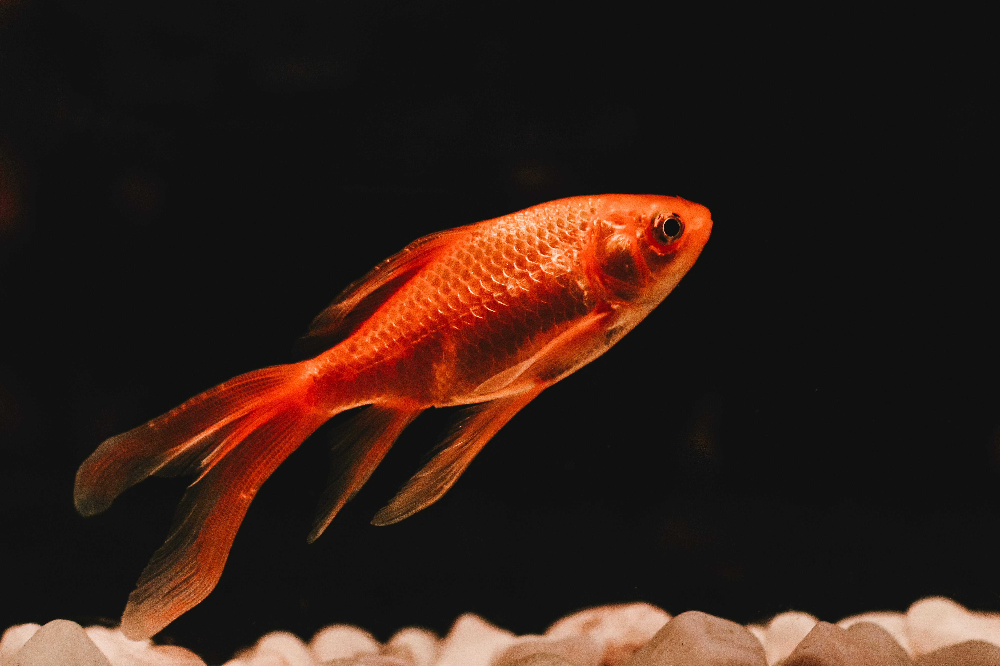

In [15]:
dodo